In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/image/Screen Shot 2021-12-30 at 4.50.09.png
/kaggle/input/image/Screen Shot 2021-12-30 at 5.47.27.png
/kaggle/input/image/Screen Shot 2022-01-04 at 21.22.55.png
/kaggle/input/image/Screen Shot 2021-12-30 at 6.09.47.png
/kaggle/input/image/Screen Shot 2021-12-21 at 19.19.07.png
/kaggle/input/image/Screen Shot 2021-12-21 at 19.16.58.png
/kaggle/input/image/Screen Shot 2022-01-04 at 21.41.01.png
/kaggle/input/image/Screen Shot 2022-01-02 at 20.35.56.png
/kaggle/input/image/Screen Shot 2021-12-30 at 5.44.00.png
/kaggle/input/image/Screen Shot 2022-01-04 at 21.15.34.png
/kaggle/input/image/Screen Shot 2021-12-30 at 5.51.47.png
/kaggle/input/image/Screen Shot 2022-01-03 at 22.15.30.png
/kaggle/input/image/Screen Shot 2021-12-22 at 20.05.13.png
/kaggle/input/image/Screen Shot 2021-12-30 at 20.39.37.png
/kaggle/input/image/Screen Shot 2021-12-30 at 6.27.30.png
/kaggle/input/image/Screen Shot 2021-12-31 at 3.47.34.png
/kaggle/input/image/Screen Shot 2021-12-30 at 5.34.58.png
/kagg

# Decision Making and Reinforcement Learning

- supervised learning (function approximation): y=f(x), given (x,y) pairs to find a function f that can map a new x to a proper y

- unsupervised learning (clusters or description): f(x), given xs to find f

- reinforcement learning: y=f(x), given xs and zs to find f and y



# MDP

mdp property: only present matters!

and the universe/environment is stationary

states: S

model: T(s,a,s') ~ Pr(s'|s,a)

actions: A(s), A

reward: R(s), R(s,a), R(s,a,s')

actually you can wrap up the the historical states into current state

and also wrap up the previous action and state into current state for reward

policy: $\pi(s)$ -> a, the solution to MDP

$\pi^*$ optimal policy that maximizes long-term expected reward

in RL, we have (s,a) pairs as training examples, and learn a policy function that maps states to actions

actually we have (s,a,r) sequences, recall y=f(x), given xs and zs to find f and y

so $\pi^*$ is f, and r is z, and y is a, and s is x

# Rewards

- delayed reward, meaning after a long state-action sequence you get a reward, and you don't know which action matters more, also related to credit assignment

- minor changes matter, cuz it will affect the policy 

- assumption of infinite horizons, meaning the agent lives forever in the environment, without this assumption, you lose the function of stationarity in your policy, $\pi(a,t)$->a

- assumption of utility of sequences (stationarity of preferences): (same starting state)

if $U(s_0,s_1,s_2,...) > U(s_0,s'_1,s'_2,...)$ 

then $U(s_1,s_2,...) > U(s'_1,s'_2,...)$ 

(if I prefer one sequence of states today over another sequence of states, then I prefer that sequence of states over the same sequence of states tomorrow)

- definition: $U(s_0,s_1,s_2,...) = \sum_{t=0}^{\infty} R(s_t)$

Existential dilemma of immortality:

which one sequence is better?

seq1: +1, +1, +1, +1, +1, +1, +1, ...

seq2: +1, +1, +1, +2, +1, +1, +2, ... 

actually neither, cuz they both converge to infinity

- discounting factor: $U(s_0,s_1,s_2,...) = \sum_{t=0}^{\infty} \gamma^t R(s_t), 0 \leq \gamma < 1$

$\sum_{t=0}^{\infty} \gamma^t R(s_t) \leq \sum_{t=0}^{\infty} \gamma^t R_{max}$

this is [geometric series](https://en.wikipedia.org/wiki/Geometric_series)

$\sum_{t=0}^{\infty} \gamma^t R(s_t) \leq \sum_{t=0}^{\infty} \gamma^t R_{max} = \frac{R_{max}}{1-\gamma}$

to prove this, let

$x=\gamma^0 + \gamma^1 + \gamma^2 + ...$

$\gamma x = \gamma^1 + \gamma^2 + ...$

$x=\gamma^0 + \gamma x$

$x(1-\gamma)=1$

$x=\frac{1}{1-\gamma}$

both side multiplied by $R_{max}$



# Policies

- the optimal polity $\pi^*$

$\pi^* = \arg \max_{\pi} E \left[ \sum_{t=0}^{\infty} \gamma^t R(s_t) | \pi \right]$

$U^{\pi}(s)=E \left[ \sum_{t=0}^{\infty} \gamma^t R(s_t) | \pi,s_0=s \right]$

rewards give immediate feedback

but utility gives long-term feedback and accounts for delayed reward

$\pi^*(s)=\arg \max_a \sum_{s'} T(s,a,s')U(s')$

with $U(s) \equiv U^{\pi^*}(s)$

- Bellman equation

$U(s) = R(s) + \gamma \max_{a} \sum_{s'} T(s,a,s')U(s')$

(max makes the equation non-linear)

we can use an algorithm to solve the Bellman equation, which is called **Value Iteration** (making jumps in value space)

1. start w/ artibary utilities

2. updata utilities based on neighbors

3. repeat until convergence

(repeat step 2,3)

$\hat{U}_{t+1}(s) = R(s) + \gamma \max \sum_{s'} T(s,a,s')\hat{U}_{t}(s')$

$\hat{U}$ is the estimated utility

**Policy Iteration** (making jumps in policy space)

1. start with $\pi_o$ <- guess

2. evaluate: given $\pi_t$ calculate $U_t=U^{\pi}_t$

3. improve: $\pi_{t+1}=\arg \max_{a} \sum_{s'} T(s,a,s')U_{t}(s')$

$U_t(s)=R(s)+\gamma \sum_{s'}T(s,\pi_t(s),s')U_{t}(s')$

without the max the above equation is linear



# the Bellman Equation

$V(s) = \max_a (R(s,a)+\gamma \sum_{s'} T(s,a,s')V(s'))$

$Q(s,a) = R(s,a) + \gamma \sum_{s'} T(s,a,s') max_{a'} Q(s',a')$

these two are from different grouping of the following equation

$V(s_1)= \max_{a_1}(R(s_1,a_1)+\gamma \sum_{s_2} T(s_1,a_1,s_2) \max_{a_2}(R(s_2,a_2)+ \gamma \sum_{s_3} T(s_2,a_2,s_3)...))$

the third bellman equation (continuation):

$C(s,a)=\gamma \sum_{s'} T(s,a,s') \max_{a'} (R(s',a')+C(s',a'))$

relationships:

$V(s)=V(s)$ 

$V(s)=\max_{a} Q(s,a)$

$V(s)=\max_a (R(s,a)+C(s,a))$

$Q(s,a)=R(s,a)+\gamma \sum_{s'}T(s,a,s')V(s')$

$Q(s,a)=Q(s,a)$

$Q(s,a)=R(s,a)+C(s,a)$

$C(s,a)=\gamma \sum_{s'} T(s,a,s')V(s')$

$C(s,a)=\gamma \sum_{s'} T(s,a,s') \max_{a'} Q(s',a')$

$C(s,a)=C(s,a)$

# Behavior Structures

- plan: fixed sequence of actions

(-) during learning, you don't know stuff, so you don't know what kind of plan to execute

(-) stochasticity, the plan worked because everything did as I expected, which means it is deterministic

in stochastic environment, you have to be aware of the surroundings

- conditional plan: includes 'if' statements

- stationary policy / universal plan 

mapping from state to action

'for every location in my neighbourhood, here is the direction you should turn'

if at every state, same!

very large

(always optimal stationary policy)



**Evaluating a Policy**

here are the agents going with three different sequences

0->+1->0->0->0->0->.... (w/ prob 0.6)

0->0->0->+1->0->0->.... (w/ prob 0.1)

0>+1->0->0->-0.2->0->.... (w/ prob 0.3)

1. state transitions to immediate rewards
2. truncate according to horizon: T=5
3. summarize sequence: Return=$\sum_{i=0}^T \gamma^i r_i, \gamma=0.8$
4. summarize over sequence: Average: weighted expectation

$0.8*0.6 + 0.8^3*0.1 + [0.8+0.8^4*(-0.2)]*0.3=0.746624$

**Evaluating a Learner**

- value of returned policy

- computational complexity (time)

- sample (experience) complexity (time): how much data it needs

# RL context

<s,a,r>\* -> RL alg -> $\pi$

- model-based

<s,a,r>\* -> model learner <-> T/R -> MDP solver -> Q\* -> argmax -> $\pi$
                   
model learner <-> T/R can be a cycle

- model-free value-based

<s,a,r>\* -> value update <-> Q\* -> argmax -> $\pi$

value update <-> Q\* can be a cycle

- policy search

<s,a,r>\* -> policy update <-> $\pi$

policy update <-> $\pi$ can by a cycle

more direct, but the learning process is difficult, because the kind of feedback that you are getting about the policy isn't very useful for directly modifying the policy

1 -> 2 -> 3   more direct learning

3 -> 2 -> 1   more supervised learning


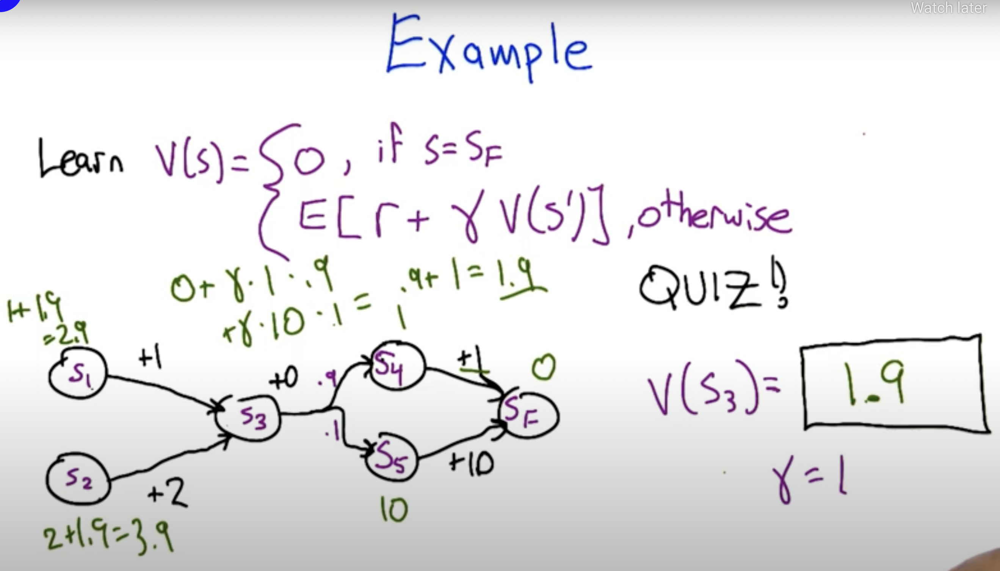

In [ ]:
import os
from IPython.display import Image
Image(filename="../input/image/Screen Shot 2021-12-21 at 19.16.58.png", width=600)

suppose we have a MDP like above

$V(s_F)=0$

$V(s_4)=E[r+\gamma V(s_F)]=1$

$V(s_5)=E[r+\gamma V(s_F)]=10$

$V(s_3)=0.9*[r+\gamma V(s_4)]+0.1*[r+\gamma V(s_5)]=0.9*(0+1*1)+0.1*(0+1*10)=1.9$

$V(s_2)=E[r+\gamma V(s_3)]=2+1*1.9=3.9$

$V(s_1)=E[r+\gamma V(s_3)]=1+1*1.9=2.9$

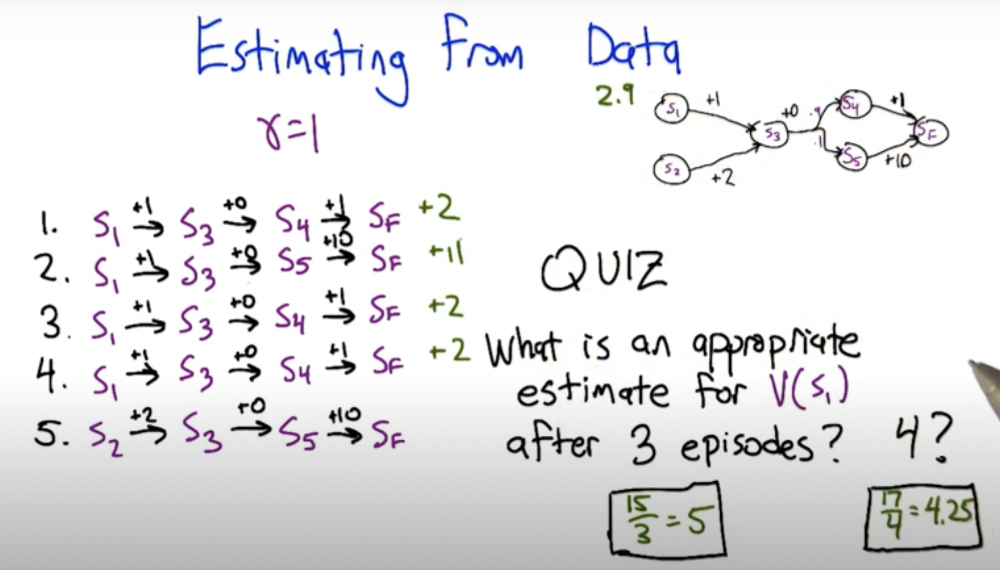

In [ ]:
Image(filename="../input/image/Screen Shot 2021-12-21 at 19.19.07.png", width=600)

given several sequences, we can estimate V of each state

**computing estimates incrementally**

suppose we have

$V_3(s_1)=5, R_4(s_1)=+2, V_4(s_1)=?$

V_underscore represents number of episodes taken

$V_4 = \frac{3*5+2}{4}=17/4$

$3*5$ means (average 5 \* total times 3) to get a whole rewards of 3 times

$3*5+2$ total for 4 times divided by 4 times

then we have

$V_{T-1}(s_1), R_T(s_1), V_T(s_1)$

$V_T(s_1)=\frac {(T-1)V_{T-1}(s_1)+R_T(s_1)}{T} = V_{T-1}(s_1)+\alpha_T(R_T(s_1)-V_{T-1}(s_1))$

where $\alpha_T = 1/T$

time difference of $R_T(s_1)-V_{T-1}(s_1)$ is the drive for learning, which is also an error

**properties of learning rates**

$V_T(s_1)= V_{T-1}(s_1)+\alpha_T(R_T(s_1)-V_{T-1}(s_1))$

$\lim_{T->\infty} V_T(s) = V(s)$

the assumption of the learning rate:

1. $\sum_T \alpha_T = \infty$, noise should be big enough so that you can move to the true value

2. $\sum_T \alpha^2_T < \infty$, but noise can not be so big to damp out the noise


|                      | $\sum \alpha_T$ | $\sum \alpha^2_T$ |
| -------------------- | --------------- | ----------------- |
| $\alpha_T=1/T^2$     |     $<\infty$   |      $<\infty$    |
| $\alpha_T=1/T$       |     $\infty$    |      $<\infty$    |
| $\alpha_T=1/T^{2/3}$ |     $\infty$    |      $<\infty$    |
| $\alpha_T=1/T^{1/2}$ |     $\infty$    |      $\infty$     |
| $\alpha_T=1/100$     |     $\infty$    |      $\infty$     |

$\alpha_T=1/100$ tells us if your learning rate doesn't get smaller over time, you are never gonna converge

$\alpha_T=1/T$ is harmonic sequence, 

$\alpha_T=1/T^2$ converges to $\pi^2/6$

if the exponent >1, then it would converge

$\sum 1/T^p$ converges, if p>1

$\sum \alpha^2_T$ is the square of $\alpha_T=1/T^{2/3}$, which is $\alpha_T=1/T^{4/3}$ converges


**TD(1)**

episode T

for all s, e(s)=0 at start of episode, $V_T(s)=V_{T-1}(s)$

after $s_{t-1}$ --$r_t$--> $s_t$, step t

$e(s_{t-1})=e(s_{t-1})+1$

for all s, 

$V_T(s)=V_T(s)+\alpha_T \left[ r_t+\gamma V_{T-1}(s_t)-V_{T-1}(s_{t-1}) \right] e(s)$

$e(s)=\gamma e(s)$

suppose a MDP

empty $s_1$ --$r_1$--> $s_2$ --$r_2$--> $s_3$ --$r_3$--> $s_F$

from $s_2$ to $s_3$

$e$ -- $\gamma (s_1)$ -- $1 (s_2)$ -- $0 (s_3)$     

$V_T(s_1) = \alpha [r_1+\gamma V_{T-1}(s_2)-V_{T-1}(s_1)]+\gamma \alpha [r_2+\gamma V_{T-1}(s_3)-V_{T-1}(s_2)]=\alpha [r_1+\gamma r_2 + \gamma^2 V_{T-1}(s_3)-V_{T-1}(s_1)]$

$V_T(s_2) = 0+\alpha [r_2+\gamma V_{T-1}(s_3)-V_{T-1}(s_2)]$

$V_T(s_3) = 0$

from $s_3$ to $s_F$

$e$ -- $\gamma^2 (s_1)$ -- $\gamma (s_2)$ -- $1 (s_3)$ -- $0 (s_3)$ 

$V_T(s_1) =\alpha [r_1+\gamma r_2 + \gamma^2 V_{T-1}(s_3)-V_{T-1}(s_1)] + \alpha \gamma^2[ r_3+ V_{T-1}(s_F)- V_{T-1}(s_3)]=\alpha [r_1+\gamma r_2 + \gamma^2 r_3 + \gamma^3 V_{T-1}(s_F)-V_{T-1}(s_1)]$

$V_T(s_2) = 0+\alpha [r_2+\gamma V_{T-1}(s_3)-V_{T-1}(s_2)]+ \alpha \gamma[r_3+\gamma V_{T-1}(s_F)- V_{T-1}(s_3)] = \alpha [r_2+\gamma r_3 + \gamma^2 V_{T-1}(s_F)-V_{T-1}(s_2)]$

$V_T(s_3) = \alpha [r_3+\gamma V_{T-1}(s_F)- V_{T-1}(s_3)]$

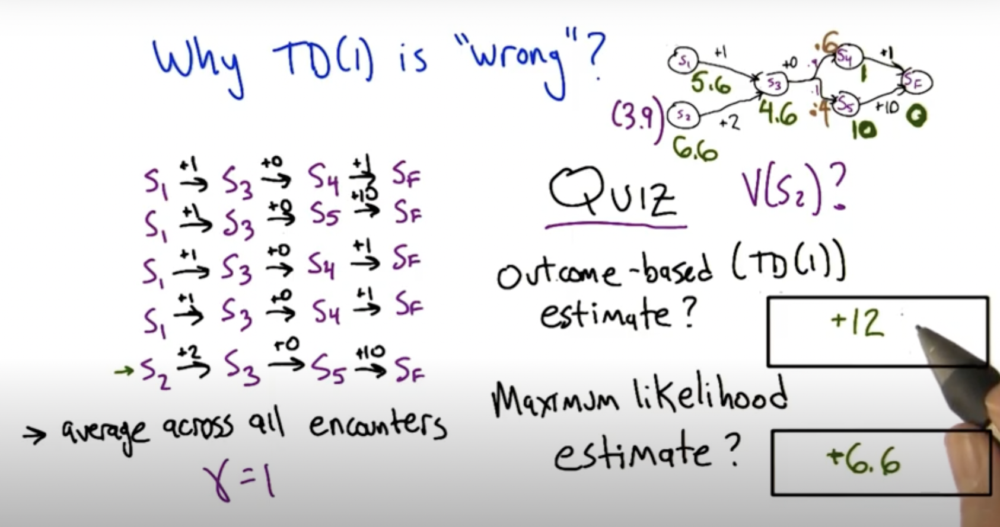

In [ ]:
Image(filename="/kaggle/input/image/Screen Shot 2021-12-22 at 20.05.13.png", width=600)

in TD(1), we only use the last sequence s2->s3->s5->sF to do the estimation

in MLE, we use all the five sequences to do the estimation, first to find out the probability of s3->s4 and s3->s5

**TD(0)**

episode T

for all s, at start of episode, $V_T(s)=V_{T-1}(s)$

after $s_{t-1}$--$r_t$-->$s_t$ (step t)

for all $s=s_{t-1}$

$V_T(s_{t-1})=V_T(s_{t-1})+\alpha_T [r_t+\gamma V_{T-1}(s_t) - V_{T-1}(s_{t-1})]$

by taking average

$V_T(s_{t-1}) = E_{s_t} [r+\gamma V_T(s_t)]$

$V_T(s_{t-1}) = E_{s_t} [r_t + \gamma r_{t+1} + \gamma^2 r_{t+2} + \gamma^3 r_{t+3} + ...]$

**TD($\lambda$) Rule**

episode T

for all s, e(s)=0 at start of episode, $V_T(s)=V_{T-1}(s)$

after $s_{t-1}$--$r_t$-->$s_t$ step t

$e(s_{t-1})=e(s_{t-1})+1$

for all s,

$V_T(s)=V_T(s)+\alpha_T[r_t+\gamma V_{T-1}(s_t)-V_{T-1}(s_{t-1})]e()$

$e(s)=\lambda \gamma e(s)$

when $\lambda=1$, it is TD(1), when $\lambda=0$, it is TD(0)

**K-step estimators**

$E1: V(s_t)=V(s_t)+\alpha_T[r_{t+1}+\gamma V(s_{t+1})-V(s_t)]$ <- TD(0)

$E2: V(s_t)=V(s_t)+\alpha_T[r_{t+1}+\gamma r_{t+2} + \gamma^2 V(s_{t+2})-V(s_t)]$

$E3: V(s_t)=V(s_t)+\alpha_T[r_{t+1}+\gamma r_{t+2} + \gamma^2 r_{t+3} + \gamma^3 V(s_{t+3})-V(s_t)]$

$Ek: V(s_t)=V(s_t)+\alpha_T[r_{t+1}+ ... + \gamma^{k-1} r_{t+k} + \gamma^k V(s_{t+k})-V(s_t)]$

$E\infty: V(s_t)=V(s_t)+\alpha_T[r_{t+1}+ ... + \gamma^{k-1} r_{t+k} + ... -V(s_t)]$ <- TD(1)

$E1: 1-\lambda$

$E2: \lambda (1-\lambda)$

$E3: \lambda^2 (1-\lambda)$

$Ek: \lambda^{k-1} (1-\lambda)$

$E\infty: \lambda^{\infty}$

$\sum^{\infty}_{k=1} \lambda^{k-1} (1-\lambda) = (1-\lambda) \sum^{\infty}_{k=1} \lambda^{k-1} = (1-\lambda) \times \frac{1}{1-\lambda} = 1$ <- geometric series

TD(1) is data-inefficient, high variance

TD(0) ML estimate

TD($\lambda$) interpolates, clearer estimates

usually TD(0.7) works well

# TD with control

without control: no action $<s_{t-1},r_t,s_t>$

$V(s)=R(s)+\gamma \sum_{s'} T(s,s')V(s')$

$V_{t}(s_{t-1})=V_{t-1}(s_{t-1})+\alpha_t[r_t+\gamma V_{t-1}(s_t)-V_{t}(s_{t-1})]$ <- TD(0)

otherwise $V_t(s)=V_{t-1}(s)$

with control: with action $<s_{t-1},a_{t-1},r_t,s_t>$

$Q(s,a)=R(s,a)+\gamma \sum_{s'} T(s,a,s') \max_{a'} Q(s',a')$

$Q_t(s_{t-1},a_{t-1})=Q_{t-1}(s_{t-1},a_{t-1})+\alpha_t [r_t+\gamma \max_{a'} Q_{t-1}(s_t,a')-Q_{t-1}(s_{t-1},a_{t-1})]$ <- TD(0)

$Q_t(s,a)=Q_{t-1}(s,a)$, otherwise

approximation 1: if we knew the model, synchronously update

$Q_t(s,a)=R(s,a)+\gamma \sum_{s'} T(s,a,s') \max_{a'} Q_{t-1}(s',a')$

approximation 2: if we knew $Q*$, sampling asynchronously update

$Q_t(s_{t-1},a_{t-1})=Q_{t-1}(s_{t-1},a_{t-1})+\alpha_t [r_t+\gamma \max_{a'} Q_{t-1}(s_t,a')-Q_{t-1}(s_{t-1},a_{t-1})]$


### Bellman operator

let B be an operator, or mapping from value functions to value functions:

$[BQ](s,a)=R(s,a)+\gamma \sum_{s'} T(s,a,s') \max_{a'} Q(s',a')$

$Q^*=BQ^*$ <=> another way of writing Bellman Equation

$Q_t=BQ_{t-1}$ <=> another way of writing value iteration

### Contraction mappings

B is an operator

if for all F,G and some $0\leq\gamma <1$

$||BF-BG||_{\infty} \leq \gamma ||F-G||_{\infty}$

then B is a contraction mapping

$||Q||_{\infty}=max_{s,a} |Q(s,a)|$: the biggest Q can be

$||F-G||_{\infty}$ : the largest difference, what's the biggest difference in Q values of F and G

In the space of real numbers, which of the following are contraction mappings?

$B(x)=x/2$

$B(x)=x+1$

$B(x)=x-1$

$B(s)=(x+100)*(0.9)$

suppose

$x=6,y=8$

$|B(x)-B(y)| \leq \gamma |x-y|$

$|7-9| > \gamma |6-8|$ so $B(x)=x+1$ not contraction

$|5-7| > \gamma |6-8|$ so $B(x)=x-1$ not contraction

$|Bx-By|=|x/2-y/2|=0.5|x-y| \leq \gamma |x-y|$, 0.5 < 1 so $B(x)=x/2$ is contraction

numerical example can be $|3-4| \leq \gamma |6-8|$ 

$|Bx-By|=|0.9*x-0.9*y|=0.9|x-y| \leq \gamma |x-y|$, 0.9 < 1 so $B(x)=(x+100)*(0.9)$ is contraction

### Contraction properties

if B is a contraction mapping

1. $F^*=BF^*$ has a solution and it is unique

2. $F_t=BF_{t-1}$ => $F_t$->$F^*$ value iteration converges

$F^*=BF^*$: fixed point equation

$||F_t-F^*||_{\infty}=||BF_{t-1}-BF^*||_{\infty} \leq \gamma ||F_{t-1}-F^*||_{\infty}$

it cannot be two fixed points, since they are distanced originally which contradicts with the contraction law

### Bellman Operator contracts

$[BQ](s,a)=R(s,a)+\gamma \sum_{s'} T(s,a,s') \max_{a'}Q(s',a')$

given $Q_1$, $Q_2$

$||BQ_1-BQ_2||_{\infty} \leq \gamma ||Q_1-Q_2||_{\infty}$

to prove this

$||BQ_1-BQ_2||_{\infty} = max_{a,s}|[BQ_1](s,a)-[BQ_2](s,a)|$

$=max_{a,s} |[R(s,a)+\gamma \sum_{s'} T(s,a,s') \max_{a'}Q_1(s',a')] - [R(s,a)+\gamma \sum_{s'} T(s,a,s') \max_{a'}Q_2(s',a')]|$

$=max_{a,s} |\gamma \sum_{s'} T(s,a,s') [\max_{a'}Q_1(s',a')-\max_{a'}Q_2(s',a')]|$

(note: from $[\max_{a'}Q_1(s',a')-\max_{a'}Q_2(s',a')]$, a' for Q1 can be different of a' for Q2, so they cannot be factorized)

$\leq \gamma \max_{s'} |\max_{a'}Q_1(s',a')-\max_{a'}Q_2(s',a')|$

(note: we remove $\max_{a,s}$ since they don't exist anymore, and we take $\max_{s'}$, the largest difference instead of weighted combination $\sum_{s'} T(s,a,s')$)

$\leq \gamma \max_{s',a'}|Q_1(s',a')-Q_2(s',a')|=\gamma ||Q_1-Q_2||_{\infty}$ <- by definition

(note: we move the $\max_{a'}$ out to combine with $\max_{s'}$ and have $\max_{s',a'}$)

### Max is a non-expansion

to prove $\gamma \max_{s'} |\max_{a'}Q_1(s',a')-\max_{a'}Q_2(s',a')| \leq \gamma \max_{s',a'}|Q_1(s',a')-Q_2(s',a')|$ is feasible 

we have to prove: 

for all f,g 

$|\max_a f(a) - \max_a g(a)| \leq \max_a |f(a)-g(a)|$

note two a can be different

| |a1|a2|a3|a4|a5|a6|a7|
|-|--|--|--|--|--|--|--|
|f|7 |9 |1 |0 |6 |3 |-2|
|g|5 |3 |8 |1 |8 |5 |5 |

$|\max_a f(a) - \max_a g(a)| = 9 - 8 = 1$

$\max_a |f(a)-g(a)| = |1-8| = 7 $ which is a3 or a7

$1 \leq 7$ so $|\max_a f(a) - \max_a g(a)| \leq \max_a |f(a)-g(a)|$ by this example

but to prove $|\max_a f(a) - \max_a g(a)| \leq \max_a |f(a)-g(a)|$, we need to use deduction

proof: without loss of generality we assume $\max_a f(a) \geq \max_a g(a)$

$|\max_a f(a) - \max_a g(a)| \leq \max_a |f(a)-g(a)| = \max_a f(a) - \max_a g(a)$

let $a_1=\arg \max_a f(a)$ and $a_2=\arg \max g(a)$

$\max_a f(a) - \max_a g(a) = f(a_1)-g(a_2) \leq f(a_1)-g(a_1)$ (since $g(a_2)$ is the largest)

$=|f(a_1)-g(a_1)|$

$\leq max_a |f(a)-g(a)|$ end of proof

In [ ]:
106*0.9-108*0.9

-1.7999999999999972

### Convergence

Define $\alpha_t (s,a)=0$ if $s_t ≠ s, a_t ≠ a$

**Theorem**: Let B be a contraction mapping and $Q^*=BQ^*$ be its fixed point. Let $Q_0$ be a Q function and define $Q_{t+1}=[B_t Q_t]Q_t$

then $Q_t$->$Q^*$ 

if

1. for all Q functions $U_1,U_2, s,a: |([B_t U_1]Q^*)(s,a)-([B_t U_2]Q^*)(s,a)| \leq (1-\alpha_t (s,a)) |U_1 (s,a) - U_2 (s,a)|$, this is non-expansion property again

2. for all $Q,U,s,a: |([B_t U]Q^*)(s,a)-([B_t U]Q)(s,a)| \leq \gamma \alpha_t (s,a) |Q^*(s,a)-Q(s,a)|$

3. $\sum_t \alpha_t = \infty, \sum_t \alpha_t^2 < \infty$

**Explained for Q-leanring**

$([B_t Q]w)(s,a) = Q(s,a)+\alpha_t(s,a)[r_t+\gamma \max_{a'} w(s_t,a')-Q(s,a)]$

$w(s,a)$ is a separate estimation of $Q(s,a)$

Q-learning satisfied the above convergence theorem

condition 1 is satisfied because: $r_t+\gamma \max_{a'} w(s_t,a')$ is kind of averaging out the stochasticity of the transition function throughout the whole process

condition 2 is satisfied because: the contraction property of bellman operator

condition 3 is satisfied

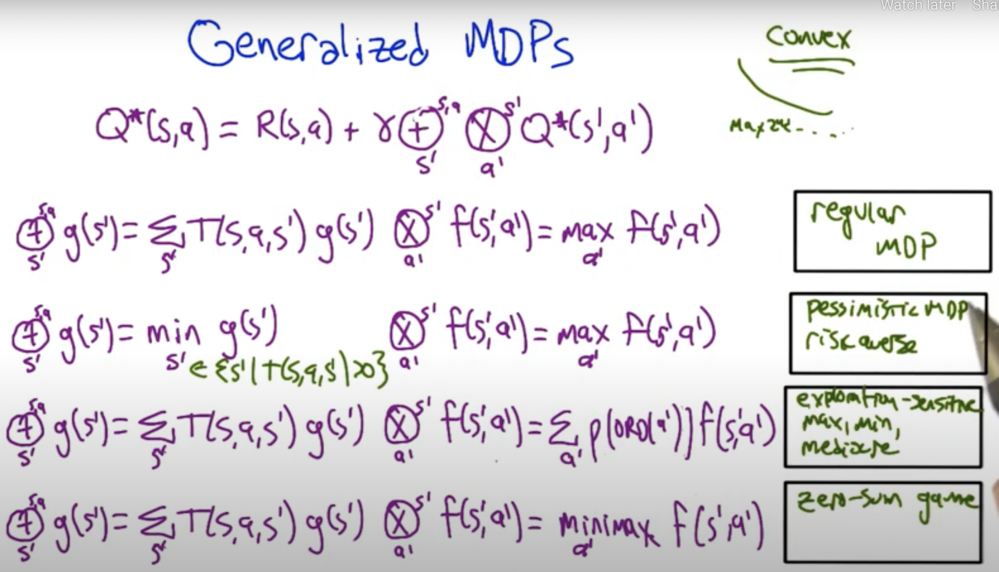

In [ ]:
Image(filename="/kaggle/input/image/Screen Shot 2021-12-25 at 22.49.02.png", width=600)

summary:

- convergence - Q-learning to Q\*, value iteration

- generalized convergence theorem

- contraction, non-expansion (order-statistics, fixed convex combinations)

- generalized MDPs

boltzmann exploration, not non-expansion

coco-Q learning, not non-expansion but converges anyway

### Advanced Algorithmic Analysis

**More on Value Iteration**

- for some $t^* < \infty$, polynomial in $|S|,|A|, R_{max}=\max_{s,a} |R(s,a)|, 1/(1-\gamma)$, bits of precision

$\pi(s) = \arg \max_a Q_{t^*}(s,a)$ is optimal

to some fixed amount of time, the greedy policy w.r.t $Q_{t^*}$ can be optimal

with the time increases, the gap between the best policy and the second policy will be large enough to have the best policy optimal

Kramer's Rule

the above thereom means, **the value iteration is eventually optimal, even it's finite**, but you don't know when it takes place

- if $|V_t(s)-V_{t+1}(s)|<\epsilon, \forall s$

$\max_{s} |V^{\pi_{V_t}}(s)-V^*(s)| < \frac{2\epsilon \gamma}{1-\gamma}$

when the value functions doesn't change any more, max of the difference between value function given the optimal policy with that value, and the optimal function is bounded

the above thereom means, **if you can get a good enough approximation of the value function, then you can at least put a bound on how far off you are in terms of following the resulting policy from how far that's going to be from optimal**

this means we can actually test on our own when is a decent time to stop

**there is a tradeoff between horizon and feasibility of solving a problem in a reasonable amount of time**

gamma close to 0 means easier problem but shortsighted, closer to one gamma is looking ahead more into the distance but can make the computation more difficult

- $||B^k Q_1 - B^k Q_2||_{\infty} \leq \gamma^k ||Q_1-Q_2||_{\infty}$

k means applying the Bellman operator k times

running k steps of value iterations pushes your value functions much closer together than a single step value iteration

**Linear Programming**

value iteration doesn't give us polynomial time to solve MDP, but linear programming does

LP is optimization framework which you can give linear constraint in a linear objective function

in polynomial time, as long as the number of variables and constraints is polynomial, get a solution

first, to encode a MDP as a linear program

the Bellman equation:

$\forall s, v_s=\max_{a} [R(s,a)+\gamma \sum_{s'} T(s,a,s')v_{s'}]$

$v_s$ is a set of equations of $V(s)$

since $\max$ is not a linear operator, the equations aren't translatable directly to a set of linear equations and a linear objective function

however, $\max$ can be spedifiable in terms of a set of linear constraints and a linear objective function

say $\max (-3,7,2,5)=x$

$x \geq -3$

$x \geq 7$ <- min x <- objective function

$x \geq 2$

$x \geq 5$

so $\forall s, v_s=\max_{a} [R(s,a)+\gamma \sum_{s'} T(s,a,s')v_{s'}]$ can be translated to a linear progamming setup, the following is called **PRIMAL**

$\min \sum_{s} v_s$ <- the objective function

$\forall s,a, v_s \geq R(s,a) + \gamma \sum_{s'} T(s,a,s')v_{s'}$

in linear programming, you can change the constraints into variables and variables into constraints, and you get a new linear program that's equivalent to the old one. this is called **DUAL**

$\max_{q_{sa}} \sum_s \sum_a q_{sa} R(s,a)$ <- maximize expected reward

s.t. $1+\gamma \sum_s \sum_a q_{sa} T(s,a,s')=\sum_{a} q_{s'a}, \forall s'$

$\forall sa, q_{sa} \geq 0$

$q_{sa}$ can be considered as policy flow

#### Policy Iteration

initialize: $\forall s, Q_0(s)=0$

policy improvement: $\forall s, \pi_t(s)=\arg \max_a Q_t(s,a), (t\geq0)$

policy evaluation: $Q_{t+1}=Q^{\pi_t}$

1. $Q_t$->$Q^*$

2. convergence is exact and complete in finite time

3. converges at least as fast as VI

**Domination**

$\pi_1 \geq \pi_2$ iff $\forall s \in S, V^{\pi_1}(s) \geq V^{\pi_2}(s)$

policy 1 dominates policy 2 iff the state value taken policy 1 is greater equal to policy 2 in any states

strict domination:

$\pi_1 > \pi_2$ iff $\forall s \in S, V^{\pi_1}(s) \geq V^{\pi_2}(s)$

and $\exists s \in S, V^{\pi_1}(s) > V^{\pi_2}(s)$

a policy is $\epsilon$-optimal iff $|V^{\pi}(s)-V^{\pi^*}(s)| \leq \epsilon, \forall s \in S$ <- bounded loss/regret

**Why does policy iteration work?**

a tale of two operators for two policies:

$\pi_1, \pi_2$

$[B_1 V] (s)=R(s,\pi_1(s))+\gamma \sum_{s'} T(s,\pi_1(s),s')V(s')$

$[B_2 V] (s)=R(s,\pi_2(s))+\gamma \sum_{s'} T(s,\pi_2(s),s')V(s')$

**B2 is Monotonic**

**Theorem:** if $V_1 \geq V_2$, then $B_2 V_1 \geq B_2 V_2$

**proof:** $(B_2 V_1 - B_2 V_2)(s)=\gamma \sum_{s'} T(s,\pi_2(s),s')[V_1(s')-V_2(s')] \geq 0$

monotonic means they preserve the ordering property

**Another property in Policy Iteration: Value Improvement**

$\pi_1$ -> $B_1$ -> $Q_1=B_1Q_1$ <- this has a unique fix point because the contraction property of B1

suppose $\pi_2$ is the greedy policy w.r.t $Q_1$, and $\pi_2$ correspondes to B2

we want to show $Q_1 \leq B_2 Q_1$

the first $Q_1$ is the fixed point of $Q_1$ from $\pi_1$, and then we do one more step of applying B2 to this $Q_1$ 

$Q_1(s,a)=R(s,a)+\gamma \sum_{s'} T(s,\pi_1(s),s') Q_1(s',\pi_1(s'))$

$\leq R(s,a)+\gamma \sum_{s'} T(s,\pi_2(s),s') Q_1(s',\pi_2(s'))$

since $\pi_2$ is greedy w.r.t $Q_1$

**Policy Iteration Proof**

we have

$\pi_1$ policy, $B_1$ operator, $Q_1$ value function w.r.t $\pi_1$

$\pi_2$ greedy policy w.r.t $Q_1$, $B_2$ operator, $Q_2$ value function w.r.t $\pi_2$

$B_2 Q_1 \geq Q_1$ <- Value Improvement

$k \geq 0, B_2^{k+1} Q_1 \geq B_2^{k} Q_1$ <- Monotonicity

$\lim_{k->\infty} B_2^{k}Q_1 \geq Q_1$ <- Transitivity

$Q_2 \geq Q_1$ <- Fixed point

Q2 is the fixed point using B2 operator

**policy iteration does not get stuck in local optimum**

V1 dominates V2 in every states

|  |V1|V2|
|--|--|--|
|s1|10|6 |
|s2|3 |3 |

|  |V1|V2|
|--|--|--|
|s1|3 |3 |
|s2|10|6 |

summary:

- VI: the greedy policy converges to optimal in a finite number of steps, or it gets bound towards that

- LP: another way to solve MDP, PRIMAL-value/DUAL-flow

- PI: domination (state-by-state basis), value non-deprovement (optimal)/value improvement, no local optima, monotonicity

### Messing with Reward

**Why might we want to change the reward function for an MDP?**

- easier to solve/represent and similar to what it would have learned

- cuz we don't have one yet (there is a true reward function associated with the behavior, but we dont know )

reward function is like a way of specifying behavior that is going to get compiled by the learning alg into actual behavior

reward function is like a programming language

1. semantics: what we want a reward function to make the agent do?

2. efficiency (change the reward function can help us improve): speed/space/sovability

speed can include experience length or computational resources

space can be the complexity of the reward function

**How can we change the MDP reward function without changing the optimal policy?**

$<S,A,R,T,\gamma>$

- multiply by positive constant (reward is unitless, but doing this doesn't change the relative strengh of different behaviors)

- shift by constant (add)

- non-linear potential based rewards

the change of the reward is not going to change the optimal policy

**Multiply by a (positive) scaler**

$Q(s,a)=R(s,a)+\gamma \sum_{s'} T(s,a,s') \max_{a'} Q(s',a')$

$R'(s,a) =c R(s,a), c >0$  (if $c<0$ reward becomes punishment)

$Q'(s,a) = c Q(s,a)$

$c Q(s,a)=c R(s,a)+\gamma \sum_{s'} T(s,a,s') \max_{a'} c Q(s',a')$

$c Q(s,a)=c R(s,a)+ c \gamma \sum_{s'} T(s,a,s') \max_{a'} Q(s',a')$

c can be canceled, then it's the original Bellman equation which has to be true

$R'(s,a) = R(s,a) + c$

$Q'(s,a) = Q(s,a) + c / (1-\gamma)$

since $Q'=Q+c+\gamma c + \gamma^2 c + \gamma^3 c + ...$ <- geometric theory

$Q(s,a) + c/(1-\gamma)=R(s,a)+ c + \gamma \sum_{s'} T(s,a,s') \max_{a'} [Q(s',a')+c/(1-\gamma)]$

$Q(s,a) + c/(1-\gamma)=R(s,a)+ c + \gamma \sum_{s'} T(s,a,s') \max_{a'} [Q(s',a')] +\gamma \sum_{s'} T(s,a,s') [c/(1-\gamma)]$

$\gamma \sum_{s'} T(s,a,s') [c/(1-\gamma)]$ has nothing to do with s' so $\sum_{s'} T(s,a,s')=1$

$Q(s,a) + c/(1-\gamma)=R(s,a)+ c + \gamma \sum_{s'} T(s,a,s') \max_{a'} [Q(s',a')] +(\gamma c)/(1-\gamma)$

$c/(1-\gamma) = c + (c \gamma)/(1-\gamma)$ multiply by $1-\gamma$

$c = c(1-\gamma) + c\gamma$

**Reward Shaping**

a series of mini rewards along the route to the big payoff that helps provide the right kind of hints

e.g, for a robot kicking a ball into the goal

score in goal +100

robot near the ball +1/distance (first try +1)

touching(hitting) the ball +10 (but the robot will shiver to get +10 all the time creating spurious optimal policies, which is suboptimal positive loop)

ball near the goal +1/distance

potential functions $c^2=c$

**To solve this, Potential-based Shaping in RL**

giving reward in the states of the world

introduce change-in-state-based bonuses

$Q(s,a)=\sum_{s'} T(s,a,s') [R(s,a,s')+\gamma \max_{a'} Q(s',a')]$

if $R(s,a,s')$ doesn't depend on s', the reward function can be popped out of sum T

$R'(s,a,s')=R(s,a)-\psi(s)+\gamma \psi(s')$

$-\psi(s)$ the potential of the state we are leaving

$\gamma \psi(s')$ the discounted potential of the state we are entering

$-\psi(s) + \gamma \psi(s')$ is the bonus we can get

every time we enter s' we are going to get some bonus, but we gotta account for the minus side of this, which is whenever I leave a state I have to lose that bonus, that's the way of avoiding those sub-optimal positive loops 

$s,s',s'',s''',s'''',...$

$Q=R+\gamma R + \gamma^2R + \gamma^3R + \gamma^4 R$

$Q=[R-\psi(s)+\gamma \psi(s')]+\gamma[R-\psi(s')+\gamma \psi(s'')]+\gamma^2[R-\psi(s'')+\gamma \psi(s''')]+...+\gamma^{\infty} \psi(s^{\infty})$

$\gamma^{\infty} \psi(s^{\infty})=0$

$Q'(s,a)=Q(s,a)-\psi(s)$

the true value of being in a state and taking an action is actually whatever the value is minus the potential you are going to lose

you are not only getting the reward all the time but also need to take into account the potential you are losing along the way

the future requires getting rid of the potential 

you have a R(s,a) including the $\psi(s)$, so you have to subtract the $\psi(s)$

$Q(s,a)-\psi(s)=\sum_{s}T(s,a,s')[R(s,a)-\psi(s)+\gamma\psi(s')+\gamma \max_{a'}(Q(s',a')-\psi(s'))]$

=> $Q(s,a)=\sum_{s}T(s,a,s')[R(s,a)+\gamma \max_{a'}(Q(s',a'))]$

the optimal policy wouldn't change, cuz we can regard $-\psi(s')$ is a constant

**Q-learning with Potentials**

$<s,a,r,s'>$

$Q(s,a):=Q(s,a)+\alpha_t [r-\psi(s)+\gamma \psi(s')+\gamma \max_{a'} Q(s',a')-Q(s,a)]$

suppose $\psi(s) = \max_a Q^* (s,a)$ <- this could not happen but anyway

$Q(s,a)=Q^*(s,a)-\psi(s)=Q^*(s,a)-\max_a Q^*(s,a)$

$Q(s,a)=0$ if a is optimal

$Q(s,a)<0$ otherwise

this means when you initialize Q to 0, you have already substracted the potential let Q<0

**Q learning with potential <=> Q learning with Q-function initialization**

it goes through the same series of action choice, it's going to do the same thing forever

it is not only gonna converge to the same policy, but have the same policy at every step

whenever you initialize your Q function randomly, you are asserting a particular potential

maybe randomness canceled out

summary:

you can mess with rewards by modifying rewards to shape agent experience without changing the optimal policy

- scale (positively)

- shift (add a constant)

- potential functions

scale and shift are linear changing of the function

but potential functions speed learning up, by trying to change the reward in a way that captured the parts of the space that were better than other (pre-potential function)

reward shaping and its dangers (positive suboptimal loops)

### Exploring Exploration

exploring set apart RL from other ML 

- bandits (don't have any state transit at all, but have stochasiticity)

- deterministic MDPs (have state transition but no stochasiticity)

- stochastic MDPs

**K-armed Bandits**

k=7

a,b,c,d,e,f,g <- which one to pull?

the one who gives you the best payoff (argmax)

however, we don't know the payoffs, because we need to explore

|    |  a |  b |  c |  d |  e |  f |  g |
|----|----|----|----|----|----|----|----|
|obs |1/10|2/20|4/40|1/5 |2/10|4/20|8/40|

the denominators are the numbers we have pulled the arms

the numerators are the payoffs we got

e.g. between a and e, e is better

the highest expected payoff: d,e,f,g

most confident: c,g (largest denominator, c is more accurate than a)

confidence is related to monotonically increasing function of the number of samples

**Confidence-based Exploration**

|    | a | b |
|----|---|---|
|obs |0/1|1/2|
|sucs|30%|70%|

which one to choose?

if i have infinite amount of time, I wanna do things that gets me more condidence in my expectations

- maximum likelihood (figure out which arm has the highest expected payoff and choose that but keep revisiting the question)

the maximum likelihood of a is 0, b is 0.5

so this strategy makes you always choose b

- maximum confidence (whichever you have the best estimates for, you should choose that one)

when you have more data, you have more confidence and then you will have more data for the confident choice forever

this strategy also makes you always choose b

- minimum confidence

you will alternate a/b, half time a, half time b, be uniform all the time

you will be uniformly going through and choosing all the arms

not bad because it at least brings you new data

- balance maximum likelihood and minimum confidence (exploration-exploitation dilemma)

the minimum confidence arm is getting you better estimates, 

but the maximum likelihood arm is getting you more reward

to do the game well, we need to think the right metric

**Metrics for Bandits**

1. identify optimal arm in the limit

2. maximize (discounted) expected reward (Gittins index)

3. maximize expected reward over finite horizon

4. identify near-optimal arm ($\epsilon$) with high probability ($1-\delta$) in time $\tau(k,\epsilon, \delta)$, the number of pulls before we can identify or before we have identified the near optial arm needs to be polynomial in ($k,1/\epsilon, 1/\delta$) <- similar like PAC (Probably approximately correct) learning

5. nearly maximize reward ($\epsilon$) with high probability ($1-\delta$) in time $\tau'(k_i,\epsilon, \delta)$ polynomial in ($k,1/\epsilon, 1/\delta$) <- the goal is to pick up as much reward as possible on the way to figuring that out

6. pull a non-near optimal arm ($\epsilon$) no more than $\tau''(k,\epsilon, \delta)$ times with high probability ($1-\delta$) <- minimize the mistake

$\tau$ is the number bounds of the pulls before we can identify the near optimal arm with high probability needs to be polynomial in ($k,1/\epsilon, 1/\delta$) 

choose 5 over 4 because it does matter how I get there not just that I got there

4,5,6 are related to each other

**Find Best => Few Mistakes**

**Algorithm A**: Algorithm that finds $\epsilon$ best arms with probability $1-\delta$ in some bounded number of $\tau(k,\epsilon,\delta)$ pulls

we can use this to build an algorithm having few mistakes

we want $\epsilon'$ close arm on $\tau'(k,\epsilon',\delta')$ pulls with probability $1-\delta'$

set $\epsilon=\epsilon', \delta=\delta'$

run Algorithm A, and after $\tau(k,\epsilon,\delta)$ pulls, we know $\epsilon'$ close arms, and pull it forever

in the whole run, how many mistakes we made?

$\tau'(k,\epsilon',\delta') \leq \tau(k,\epsilon,\delta)$

**Few mistakes => Do well**

**Algorithm B**: we have an algorithm that pulls $\epsilon$-suboptimal arms at most $\tau(k,\epsilon,\delta)$ times with probability $1-\delta$

we want an algorithm that with high probability $1-\delta'$ has a per-step reward $\epsilon'$ close to optimal after $\tau'(k,\epsilon',\delta')$ steps

let $\epsilon'=\epsilon, \delta'=\delta$, run Algorithm B



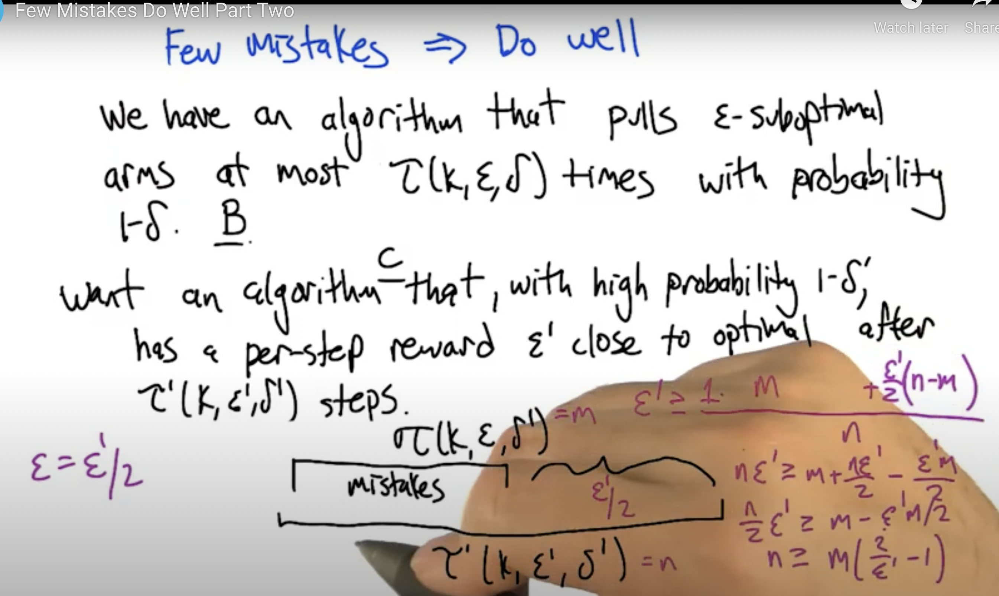

In [ ]:
Image(filename="../input/image/Screen Shot 2021-12-30 at 19.47.53.png", width=600)

**Do well => Find Best**

**Algorithm C:** gets within $\epsilon$ (per step) of optimal after $\tau(k,\epsilon,\delta)=n$ pulls with probability $1-\delta$

we want Algorithm A which after $\tau'(k,\epsilon',\delta')$ pulls, returns an arm that is $\epsilon'$ optimal, up $1-\delta'$

let's run Algorithm C: per step near optimal payoff

$e_i$: suboptimality of the plurality arm

$e_i \leq \epsilon'$, let $\epsilon=\epsilon'/k$

$\epsilon \geq e_i (1/k)$, $e_i \leq \epsilon_k$

**Hoeffding bound**

Let $x_1,...,x_n$ be iid with mean $\mu$. let $\hat{\mu}$ be our estimate of $\mu: \sum_i x_i/n$

the following is a $100(1-\delta)%$ confidence interval for $\mu$:

$\left[ \frac{\hat{\mu}-Z_{\delta}}{\sqrt{n}}, \frac{\hat{\mu}+Z_{\delta}}{\sqrt{n}}   \right]$, $Z_{\delta}=\sqrt{1/x \ln (2/\delta)}$

Hoeffding bound gives us how many samples we need to accurately learn the value of an arm

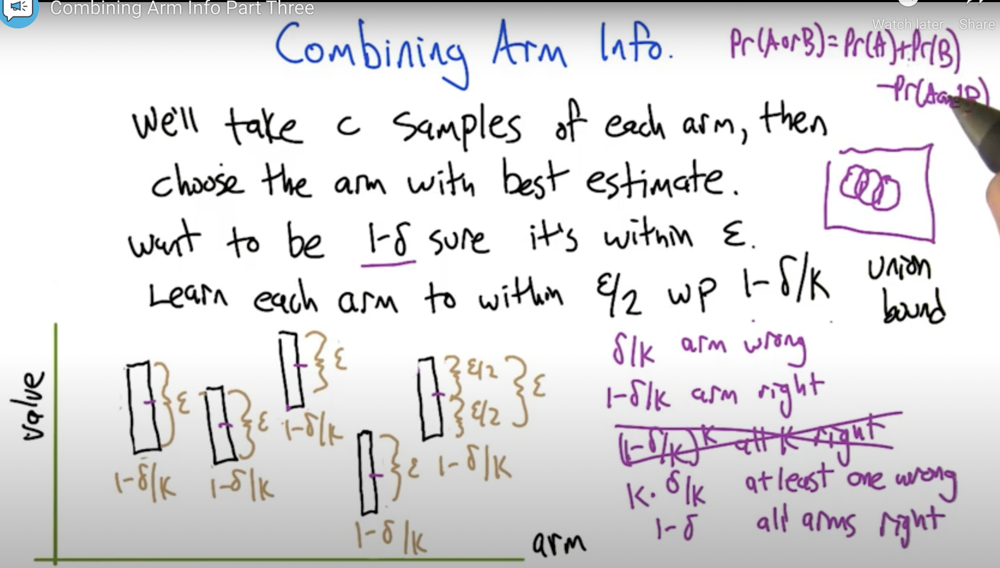

In [ ]:
Image(filename="../input/image/Screen Shot 2021-12-30 at 20.39.37.png", width=600)

**How many samples?**

we want to be $\epsilon/2$ accurate with probability $1-\delta/k$ (certainty

substituting these values into Hoeffding bound, we have

$\frac{\sqrt{1/2 \ln (2k/\delta)}}{\sqrt{c}} \leq \epsilon/2$

then we have

$c \geq 2 (1/\epsilon^2) \ln (2k/\delta)$

this means if we sample the arms this many, we are going to be sufficiently certain that we are sufficiently close that choosing the maximum arm is going to be a good idea

what we found is PAC-style bounds for bandits

#### Exploring Deterministic MDP

1. 1≠2

2. try each action once per state

3. solve MDP

4. explore randomly


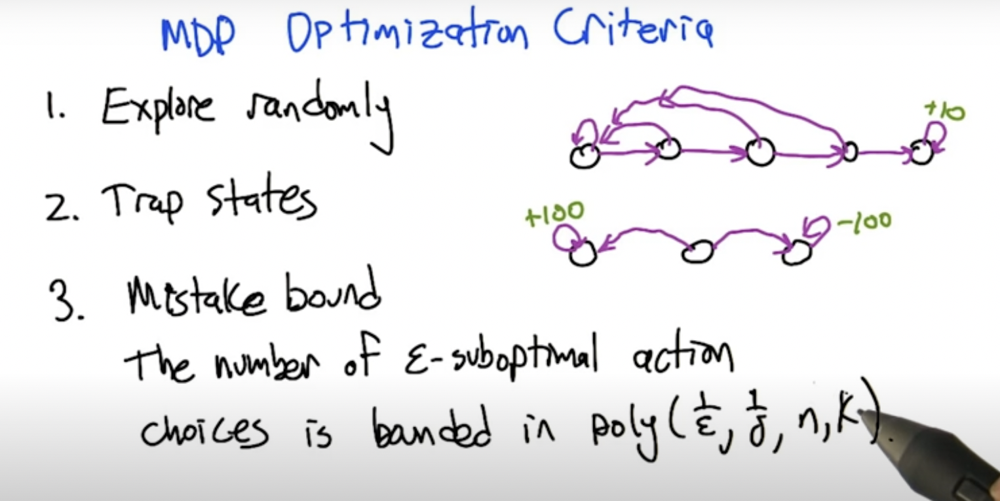

In [ ]:
Image(filename="../input/image/Screen Shot 2022-01-02 at 20.35.56.png", width=600)

#### Rmax

1. keep track of MDP

2. any unknown state-action pair is Rmax

3. solve the MDP

4. take action from $\pi^*$

#### Rmax Analysis - an efficient alg for deterministic MDP

1. once all edges known, no more mistakes

2. stop visiting unknown states? if we loop w/o learning anything - no mistakes

3. we execute a path to an unknown state-action pair

the number of steps that it might take to get to that new state action pair is: n

the number of times we might discover a new state action pair is : nk (k is the number of actions)

so the total number of mistakes that this algorithm can make is bounded by $O(n^2k)$

in a nutshell, wheneve we don't know something, assume it's awesome and behave accordingly.

if we learned something new, make note of it

so the number of times that we take a step that might not be the best thing to do for that state, it can't be any bigger than n squared k

#### Lower Bound

**we have an upper bound that says that our alg is not going to take any longer than $n^2k$ steps to explore a deterministic MDP**

there is a lower bound said that no alg can do better than $n^2k$

which means the algorithm is doing well



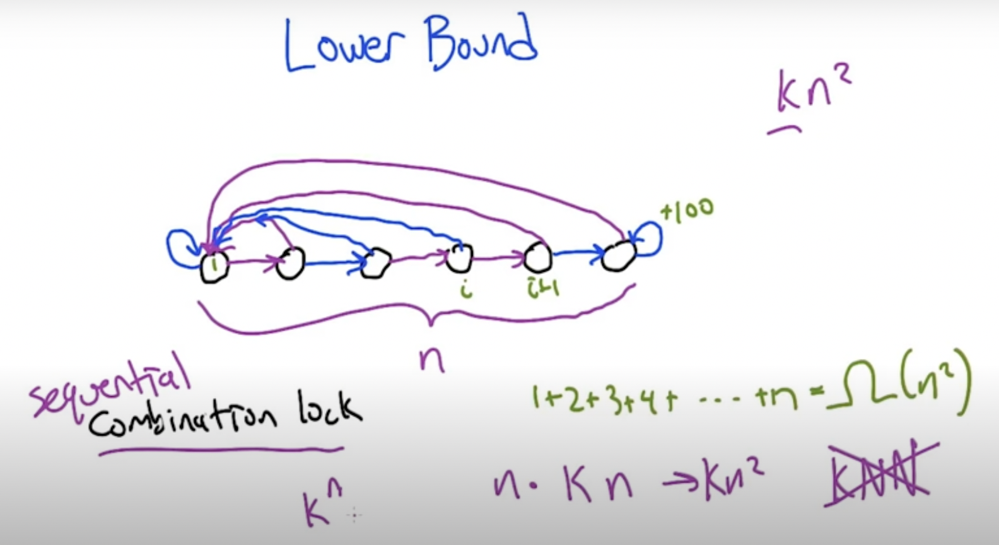

In [ ]:
Image(filename="../input/image/Screen Shot 2022-01-02 at 21.44.33.png", width=600)

#### General Stochastic MDPs

what we have

- stochastic (Hoeffding bound until estimates are accurate)

- sequential (unknown state-action pairs assumed optimistic)

#### General Rmax

recall Rmax

1. keep track of MDP

2. any unknown state-action pair is Rmax

3. solve the MDP

4. take action from $\pi^*$

the General Rmax modifies step 2 of Rmax to define **unknown**

we have some parameter c, that state action pair is unknown if it's been visited or tried out fewer than c times

then we use Maximum Likelihood estimate

this gives us a new estimate of the transitions and rewards based on the data we've actually gathered

this parameter c is related to Hoeffding bound we used for stochastic non-sequential case in the bandit

#### Simulation Lemma (a lemma about simulation)

if we have a pretty good estimate of the real MDP, then optimizing our rewards in that estimate is going to be pretty good in the real MDP

transitions and rewards off by $\alpha$ or less

with any fixed $\pi$, we want to compare the value we get for following $\pi$ in MDP1, and MDP2

$V_1^{\pi}(s), T_1, R_1$

$V_2^{\pi}(s), T_2, R_2$

if these are going to be near each other given that T1 is near T2, and R1 is near R2, then this gives us the ability to have accurate simulations

$\max_{s,a,s'} |T_1(s,a,s')-T_2(s,a,s')| \leq \alpha$

$\max_{s,a} |R_1(s,a)-R_2(s,a)| \leq \alpha$

without loss of generality, assume that $R \in [0,1]$ and $T \in [0,1]$, we can use the same $\alpha$ to bound them

Define $G=\alpha + \gamma n \alpha R_{max}/(1-\gamma)$

$\epsilon = |V_1^{\pi}(s)-V_2^{\pi}(s)| \leq G/(1-\gamma)$

if we estimate perfectly, $\alpha=0$, these two value functions are identical

=> $\alpha=\epsilon(1-\gamma)/[1+\gamma n R_{max}/(1-\gamma)]$

we want to simultaneously make $\alpha$ close estimate hold across all state action pairs

so we need to make c big enough so that the probability that it fell in any one of them is sufficiently small

it's like the bandit problem, c + Hoeffding bound and union bound

#### Explore or Exploit Lemma

(with high probability) if all transitions either accurately estimated or unknown

optimal policy is either near optimal or an unknown state is reached 'quickly' (in polynomial number of steps)

the number of times that we can learn something new is bounded by the number of states times the number of actions (nk)

the number of steps before we learn something new is bouned by a polynomial in the various quantities

=> we cannot learn in a very long time without either learning something new or being near optimal

summary:

- bandits, decision making w/ randomness

Hoeffding bound, union bound (learn how the world works)

to convince ourselves that we have a sufficiently accurate estimate that we can get near optimal reward in these kind of non-sequential but stochastic decision problems

these bounds told us how certian we are, or if we are certain enough

- Rmax in deterministic MDP: optimism in the face of uncertainty

explore at a distance, grass is always greener until we get there and learn otherwise

- combined the aboves: Rmax + bandits (stochastic + sequential)

KWIK learning: learning transition probabilities using methods that know what they know, and if it can distinguish between known and unknown, it can associate optimism with the unknown and then we can make guarantees on how uniquely and efficiently near optimal behavior can be learned

### Generalization

to leverage learning in states where we've been to try to make predictions about states where we haven't been or haven't been very often

**Inductive Bias**

something refer to the way algorithms preferred one solution over another

different features sort of create different kind of inductive biases by making some states look more similar

e.g. if we had this egocentric notion of how far away a person is from a taxi

then so long as a person is two steps away from a taxi, any state where a person is two steps away from a taxi looks the same or looks very similar

some **representations** are better for some things than others

#### Generalization Idea

in RL

**policy: (mapping) states -> actions**

generalization of policy means similar states have similar actions, then we could learn what the right action is for some states and then guess what the right action is for other states, using function approximation or other ML methods

across lots of related states, we could be using the same kind of action

sometime learning a policy directly is difficult, so we learn value function

**value function: (mapping) states/actions -> estimated return (rewards)**

generalization of value function is an option, that similar state action pairs have similar returns, then we can do function approximiation for Q

**model T/R: s,a -> s'**

can do function approximation and generalization for the model as well, they are supervised examples of transitions

#### Basic Update Rule

General form: $Q(s,a)=F(w^a,f(s))$

$w^a$ - one set of parameters for each action

$f(s)$ - take a state and translate it into a set of features

$<s,a,r,s'>$, a gradient update rule will be

$\Delta w_i^a=\alpha \left[ r+\gamma \max_{a'} Q(s',a') - Q(s,a)\right] \partial Q(s,a)/ \partial w_i^a$

an analogy to supervised learning: 

$r+\gamma \max_{a'} Q(s',a')$ <-> $y*$ (true label)

$Q(s,a)$ <-> $y$ (estimated label)

bootstrapping: using current estimate $Q$ in $\max_{a'} Q(s',a')$ as a target for the other prediciton should be moving toward

$Q(s,a)=\sum_{i=1}^n f_i(s) w_i^a$

$w_i^a$ parameters provide generalization since all the states share these weights

each action gets a set of n weights to represent the Q values for that action

dot product weights give 'importance' of all the features in contributing to an action's value

$\partial Q(s,a)/ \partial w_i^a = f_i(s)$

#### Does it work?

successes:

3-layer backprop/Backgammon/Jeopardy in Watson: Tesauro, Wang/Dietterich

CMAC: Sutton

Linear nets: Sign, Parr

Deep nets: Minh et al <- Atari

Tesauro (TD Gammon) -> Boyan/Moore (need not work) -> Sutton (but it can if you do it right)

Pollack - Genetic alg can also do backgammon well

'because it is so random, it forces you to do all kinds of exploration and keep you from falling into certain traps, which made generalization powerful'

**features should be computationally efficient and value-informative**, like distance to the passenger in taxi task

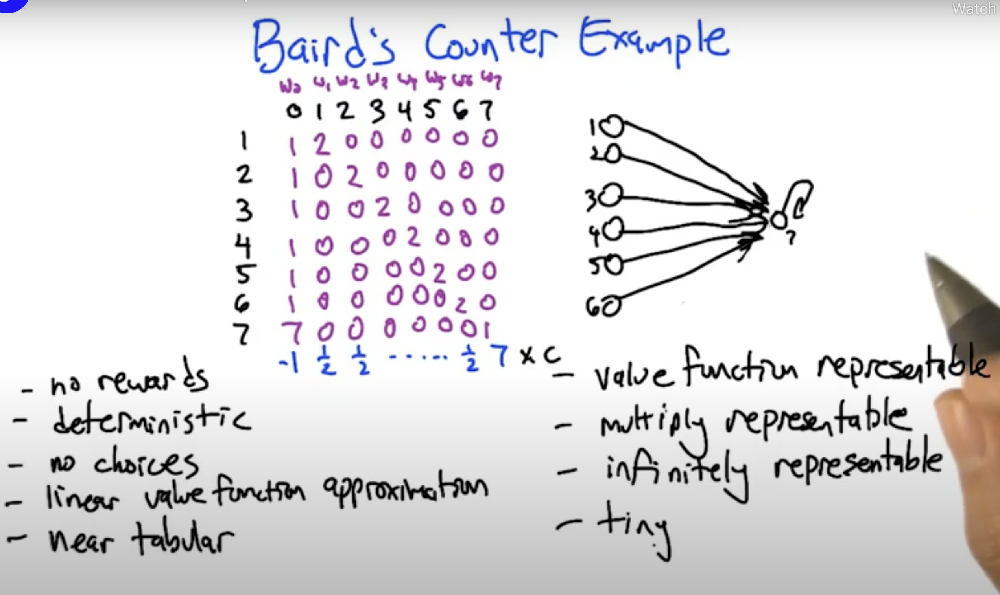

In [ ]:
Image(filename="../input/image/Screen Shot 2022-01-03 at 22.15.30.png", width=600)

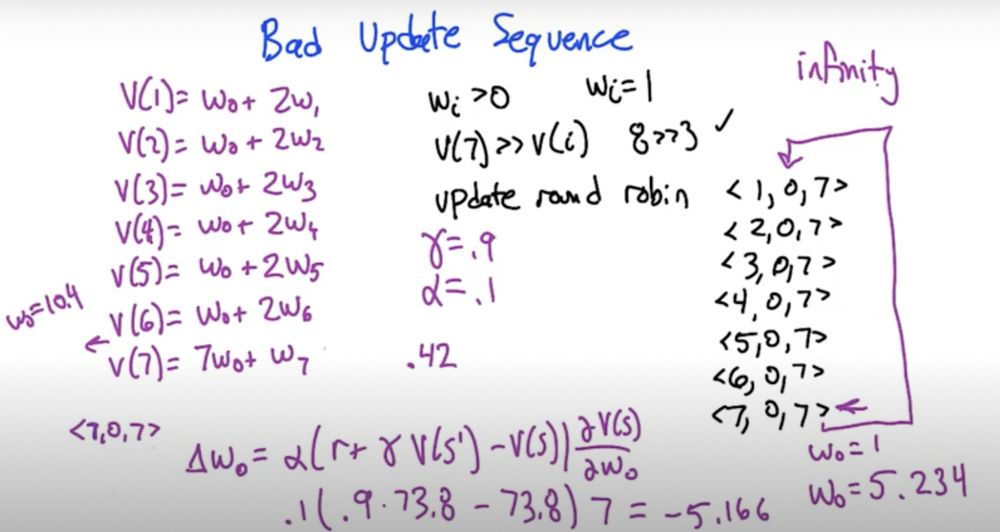

In [ ]:
Image(filename="../input/image/Screen Shot 2022-01-04 at 21.15.34.png", width=600)

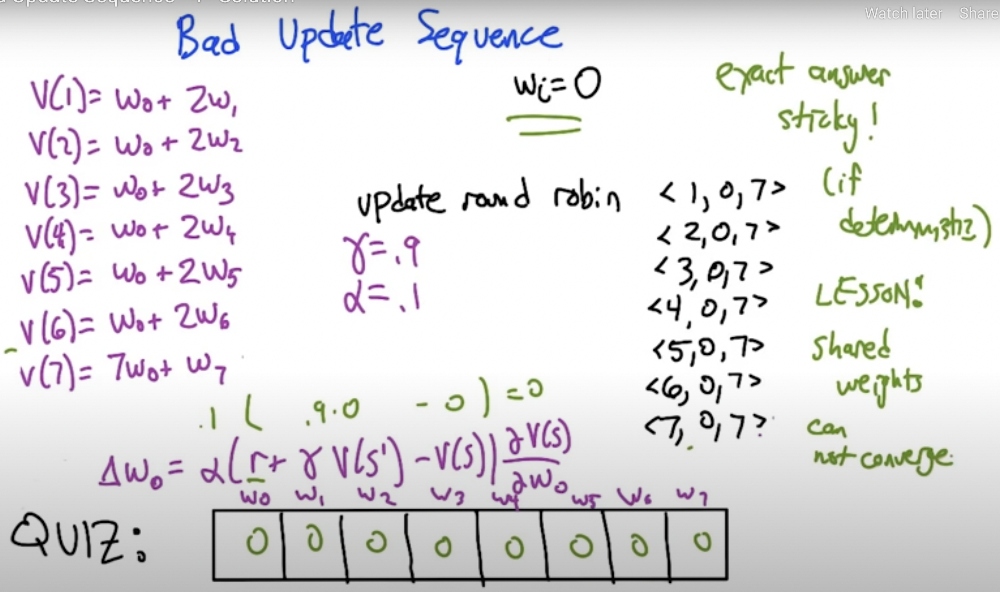

In [ ]:
Image(filename="../input/image/Screen Shot 2022-01-04 at 21.22.55.png", width=600)

### Linear Approximation does not always converge

the case where linear approximation fails

if you are doing this generalization where everything kind of depends upon everything else, because you're having these shared weights in your value function

then even in a simple linear case, you cannot always converge, this is not guaranteed

this is bad, because usually if we stick to linear functions, things are easier

we have no way of assuring ourselves that it will converge, unless we deviate from some properties of this particular example

### Averager Function Approximators [Jeff Gordon]

convex combination of anchor point / interpolative / exterpolative

$V(s)=\sum_{s_b \in B} w(s,s_b)V(s_b)$

s.t. $w(s_1,s_b) \geq 0, \forall s,s_b$

$\sum_{s_b \in B} w(s,s_b)=1, \forall s$

$B$ - basis/anchor points

$V(s_b)$ - parameters

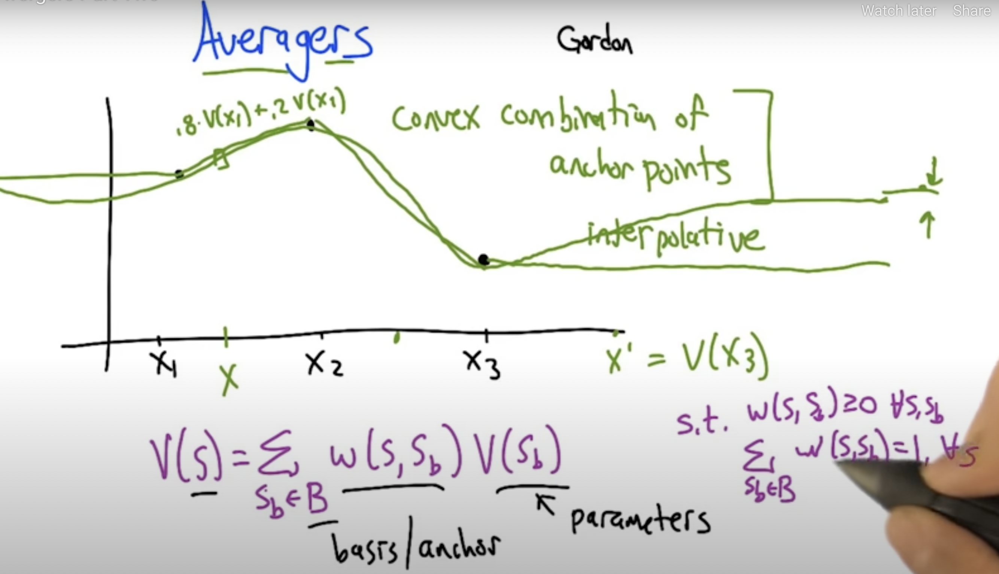

In [ ]:
Image(filename="../input/image/Screen Shot 2022-01-04 at 21.41.01.png", width=600)

supervised learner that can be expressed as an averager?

KNN, distance weighted, kernel 

#### Connection to MDPs

$V(s)=\max_a \left[R(s,a)+\gamma \sum_{s'} T(s,a,s') V(s') \right]$

replace $V(s')$ with the averager $\sum_{s_b \in B} w(s',s_b) V(s_b)$

$V(s)=\max_a \left[R(s,a)+\gamma \sum_{s'} T(s,a,s') \sum_{s_b \in B} w(s',s_b) V(s_b) \right]$

$=\max_a \left[R(s,a)+\gamma \sum_{s_b \in B} \left( \sum_{s'} T(s,a,s')  w(s',s_b) \right) V(s_b) \right]$

replace $\sum_{s'} T(s,a,s')  w(s',s_b)$ with $T'(s,a,s_b)$

$T'(s,a,s_b)$ means choose a state, you take an action, what basis functions will you go to next?

$\sum_{s_b \in B} T'(s,a,s_b) = 1$, because it is a convex combination

then 

$V(s)=\max_a \left[R(s,a)+\gamma \sum_{s_b \in B} T'(s,a,s_b) V(s_b) \right]$

$s$ -> $s'$ -> $s_{bs}$ 

$s_{bs}$ means $s_{b1}$ or $s_{b2}$ or $s_{b3}$ ...

and the weights on these probabilities are the convex combination weights

convex combination weights are like probabilities

so it's as if each time we make a transition to a next state s', we make an additional little transition to each of the basis states, from there we continue

then we solve out what the value function is over everything, by just solving the MDP over the basis states, then we extrapolate or interpolate that to anything we want

however, value functions usually have weird cliff for not capturing the well smoothed curves with nice averaging properties

summary:

- need (zillions of states) for and methods (supervised learning methods) for generalization in RL

- linear function approximation

value functions (gradient form) / policies (gradients) / models

- succeses (TD gammon, Atari)

- problems (even linear need not work)

GTD2 shows proveable convergence linear

fitted Q iteration, mixing function approximation and Q value learning together (maynot converge but worked decently)

- averagers (convergence)

the function approximater could be viewed as kind of MDP itself

there is a unique value function can be converged to

as the anchor points increases, the error in the value function approximation goes down

LSPI (Least Square Policy Iteration)

latex, symbols

https://oeis.org/wiki/List_of_LaTeX_mathematical_symbols